In [1]:
#explore the CD4 t cells
import scanpy as sc #for scanpy >= 1.3.7
import anndata as ann
import numpy as np
import scipy as sp
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib import rcParams
from matplotlib import colors
import seaborn as sb
import logging
import os
import glob
import matplotlib
import math

In [2]:
def pca_elbow(adata, n_genes, n_pca_pcs, name):
    rcParams['figure.figsize']=(8,8)
    rcParams['font.size']=16
    
    sc.pp.highly_variable_genes(adata, flavor='cell_ranger', n_top_genes=n_genes)
    sc.pp.pca(adata, n_comps=n_pca_pcs, use_highly_variable=True, svd_solver='arpack')
    sc.pl.pca_variance_ratio(adata, log=False, save = '_{}.png'.format(name))
    
def removegenes(adata):
    """remove human HLA genes from the dataset 
    Parameters:
    ----------
    adata: scanpy.adata
        scanpy adata object

    Returns:
    -------
    temp: scanpy.adata
        scanpy adata object
    """
    IGKV = [x for x in adata.var_names if x.startswith('IGKV')]
    IGHV = [x for x in adata.var_names if x.startswith('IGHV')]
    IGLV = [x for x in adata.var_names if x.startswith('IGLV')]
    IGLC = [x for x in adata.var_names if x.startswith('IGLC')]
    IGLL = [x for x in adata.var_names if x.startswith('IGLL')]
    IGKC = [x for x in adata.var_names if x.startswith('IGKC')]
    IGHC = [x for x in adata.var_names if x.startswith('IGHC')]
    TRAV = [x for x in adata.var_names if x.startswith('TRAV')]
    TRBV = [x for x in adata.var_names if x.startswith('TRBV')]
    
    exclude = IGKV + IGHV + IGLV + IGKC + IGHC + IGLL + IGLC+TRAV + TRBV 
    gene = [x for x in adata.var_names if x not in exclude]
    temp = adata[:,gene].copy()
    return(temp)
from sklearn.datasets import make_blobs
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_samples, silhouette_score


def sil_cal(adata, res_list, n_knn_pcs):
    key_list = []
    for res in res_list:
        key_list.append('res_{}'.format(res))
        sc.tl.leiden(adata, resolution=res, key_added = 'res_{}'.format(res))
        
    pca_matrix = adata.obsm['X_pca'][:,0:n_knn_pcs]
    sil_df = pd.DataFrame(index = adata.obs.index, columns = key_list)
    info_df = pd.DataFrame(index = key_list, columns = ['n_clusters', 'sil_avg', 'res'])
    
    info_df['res'] = res_list
    
    for res_name in key_list:
        
        labels = adata.obs[res_name].to_numpy(dtype = int)
        n_clusters = len(adata.obs[res_name].unique())
        
        info_df.loc[res_name, 'n_clusters'] = n_clusters
        
        if labels.sum() == 0:
            print('At resolution {} only 1 cluster is defined, skip to the next resolution'.format(res_name.split('_')[1]))
            sil_df[res_name] = 0
            info_df.loc[res_name, 'sil_avg'] = 0
            continue
        else:
            silhouette_avg = silhouette_score(pca_matrix, adata.obs[res_name].to_numpy(dtype = int))
            sample_silhouette_values = silhouette_samples(pca_matrix, adata.obs[res_name].to_numpy(dtype = int))
            sil_df[res_name] = sample_silhouette_values
            info_df.loc[res_name, 'sil_avg'] = silhouette_avg
            print('At resolution {} the average silhouette score is {}'.format(res_name.split('_')[1], silhouette_avg))
            
    return(sil_df, info_df)

def summary_plot(info_df, path, name):
    temp_df = info_df.loc[info_df.sil_avg != 0]
    
    rcParams['figure.figsize']=(20,10)
    rcParams['font.size']=22
    fig, (ax1, ax2) = plt.subplots(1, 2)
    sb.scatterplot(data = temp_df, x = 'res', y = 'sil_avg',s =200, 
                   alpha = 0.5, color = 'black', edgecolor = 'k', ax = ax1)
    sb.scatterplot(data = temp_df, x = 'n_clusters', y = 'sil_avg',s =200, alpha = 0.5, 
                   color = 'black', edgecolor = 'k', ax = ax2)
    
    ax1.set_xlabel("Resolution")
    ax1.set_ylabel("Average silhouette score")
    ax2.set_xlabel("Cluster numbers")
    ax2.set_ylabel("Average silhouette score")

    save_dir = os.path.join(path, name)
    fig.savefig(save_dir, bbox_inches='tight')
#   plt.close()

In [3]:
adata_savepath = '/domino/edv/id-td-virology/Zhiyuan/public/Gut_remap/processed_data/annotated.h5ad'
adata= sc.read_h5ad(adata_savepath)

In [5]:
list(adata.obs.GeneralAnnotation.unique())

['CD3+',
 'NK',
 'Doublets',
 'Proliferating',
 'Macrophage',
 'B-cell',
 'unknown',
 'Plasma',
 'DC',
 'LSECs',
 'Monocyte',
 'Platelets']

In [6]:
adata_high = adata[adata.obs.cell_quality == 'high'].copy()

In [7]:
adata_high

AnnData object with n_obs × n_vars = 288764 × 36601
    obs: 'sample_id', 'n_genes_by_counts', 'total_counts', 'pct_counts_in_top_50_genes', 'total_counts_mt', 'pct_counts_mt', 'cell_quality', 'FinalAnnotation', 'SecondAnnotation', 'GeneralAnnotation', 'patient_id', 'tissue', 'Gender', 'Group', 'Age (years)', 'Time since HBV diagnosis (years)', 'HBsAg (COI)', 'HBsAb (IU/L)', 'HBeAg (COI)', 'HBeAb (COI)', 'HBcAb (COI)', 'HBsAg level (IU/ml)', 'HBV DNA level (log10 IU/ml)', 'ALT (U/L)', 'AST (U/L)', 'Stage'
    var: 'gene_ids', 'feature_types', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'

In [8]:
adata_t = adata_high[adata_high.obs.GeneralAnnotation == 'CD3+'].copy()

In [9]:
adata_t.obs.groupby('FinalAnnotation').size()

FinalAnnotation
CD4+CentralMemory      27239
CD4+Naive              20593
CD4+TNaive              5073
CD4+TResidentMemory     6468
CD4+Th1-like            2510
CD4+Treg                2635
CD8+EffectorMemory      2330
CD8+Naive               9262
CD8+TCentralMemory      6510
CD8+TEffector          36617
CD8+Texhausted         25507
DN-Tcell                 529
MAIT                   16586
gdT                     6283
dtype: int64

In [28]:
ind_CD4 = adata_t.obs.loc[(adata_t.obs.SecondAnnotation == 'CD4+') & 
                          ((adata_t.obs.FinalAnnotation != 'CD8+TEffector') &
                          (adata_t.obs.FinalAnnotation != 'CD8+TCentralMemory'))].index

adata_CD4 = adata_t[ind_CD4,:].copy()

In [29]:
adata_CD4.obs.groupby('FinalAnnotation').size()

FinalAnnotation
CD4+CentralMemory      27239
CD4+Naive              20593
CD4+TNaive              5073
CD4+TResidentMemory     6468
CD4+Th1-like            2510
CD4+Treg                2635
dtype: int64

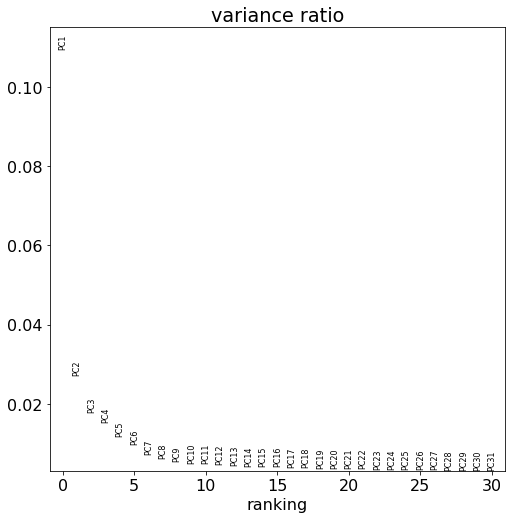

At resolution 0.1 the average silhouette score is 0.3654550313949585
At resolution 0.2 the average silhouette score is 0.3027136027812958
At resolution 0.3 the average silhouette score is 0.15813204646110535
At resolution 0.4 the average silhouette score is 0.15653561055660248
At resolution 0.6 the average silhouette score is 0.04633038863539696
At resolution 0.8 the average silhouette score is 0.04682251438498497
At resolution 1 the average silhouette score is 0.05920078232884407
At resolution 1.5 the average silhouette score is 0.06334301084280014


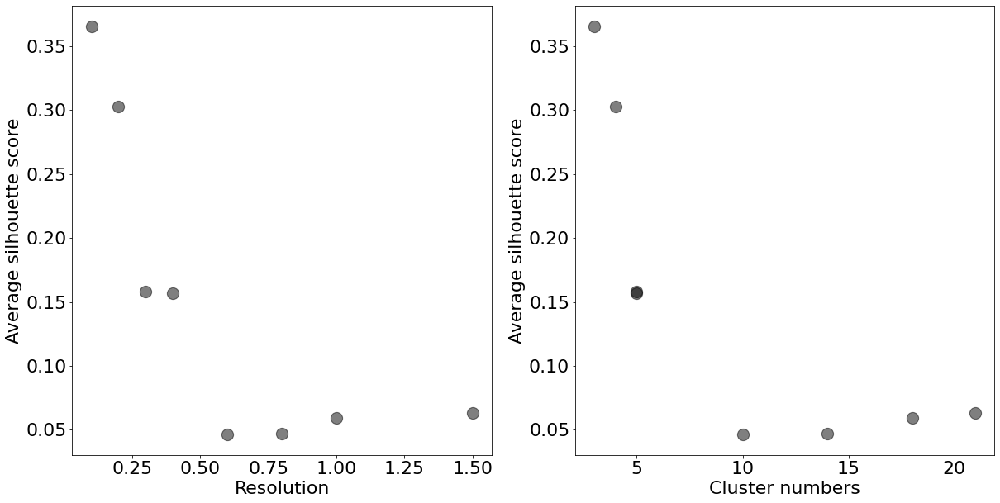

In [30]:
#let's do a quick cluster on CD4 cells
adata_CD4 = removegenes(adata_CD4)
sc.pp.filter_genes(adata_CD4,min_cells=3)
 
sc.settings.figdir = '/domino/edv/id-td-virology/Zhiyuan/public/Gut_remap/figure/T_cells/CD4/'
pca_elbow(adata_CD4, 2000, 50, 'CD4')
sc.external.pp.bbknn(adata_CD4, batch_key='tissue', neighbors_within_batch=10, n_pcs=10)
res_list = [0.1, 0.2, 0.3, 0.4, 0.6, 0.8, 1, 1.5]
temp_adata = adata_CD4.copy()
test_df, info_df = sil_cal(temp_adata, res_list, n_knn_pcs = 10)
figpath = '/domino/edv/id-td-virology/Zhiyuan/public/Gut_remap/figure/T_cells/CD4/'
summary_plot(info_df, figpath, 'sil_summary_CD4.png')

In [31]:
#try resolution 0.4
adata_CD4.obs['leiden_r0.4'] = temp_adata.obs['res_0.4']
sc.tl.umap(adata_CD4)

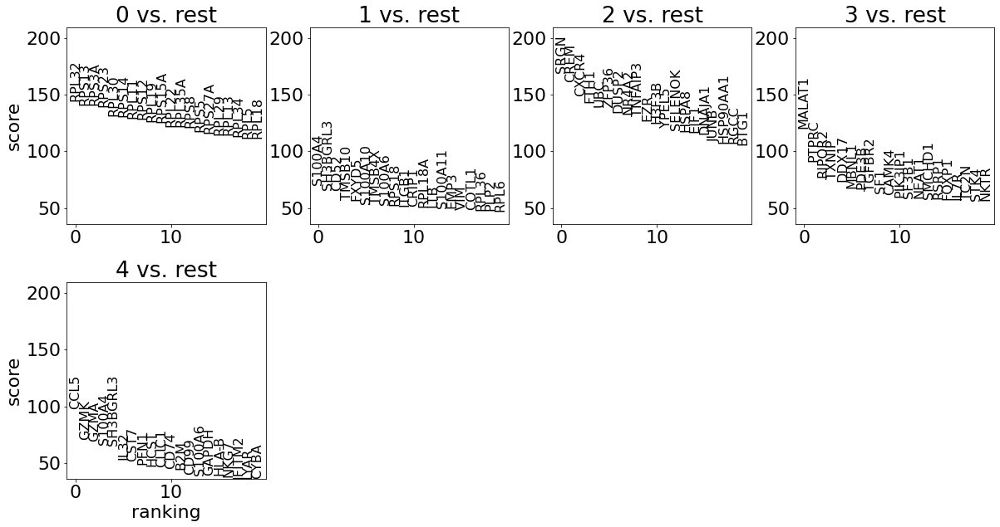

In [32]:
sc.tl.rank_genes_groups(adata_CD4, groupby='leiden_r0.4', key_added='rank_genes_r0.4', 
                        use_raw = False, method = 'wilcoxon')
rcParams['figure.figsize']=(5,5)
sc.pl.rank_genes_groups(adata_CD4, key='rank_genes_r0.4', fontsize=16, use_raw = False)

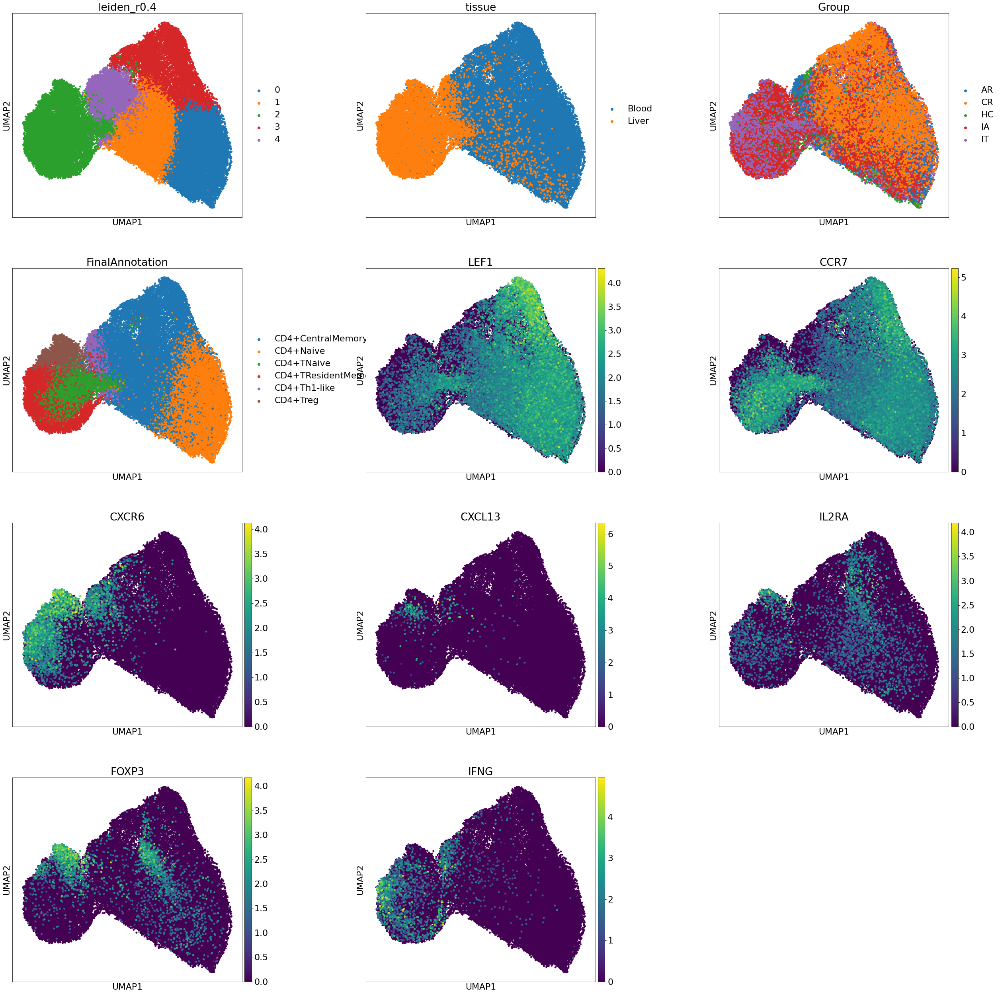

In [38]:
rcParams['figure.figsize']=(10,10)
sc.pl.umap(adata_CD4, color=['leiden_r0.4', 'tissue', 'Group', 'FinalAnnotation',
                                'LEF1','CCR7','CXCR6', 'CXCL13', 'IL2RA', 'FOXP3', 'IFNG'],wspace = 0.4,
           s =100, ncols = 3, use_raw = False)

In [39]:
#try resolution 1
adata_CD4.obs['leiden_r1'] = temp_adata.obs['res_1']
sc.tl.umap(adata_CD4)

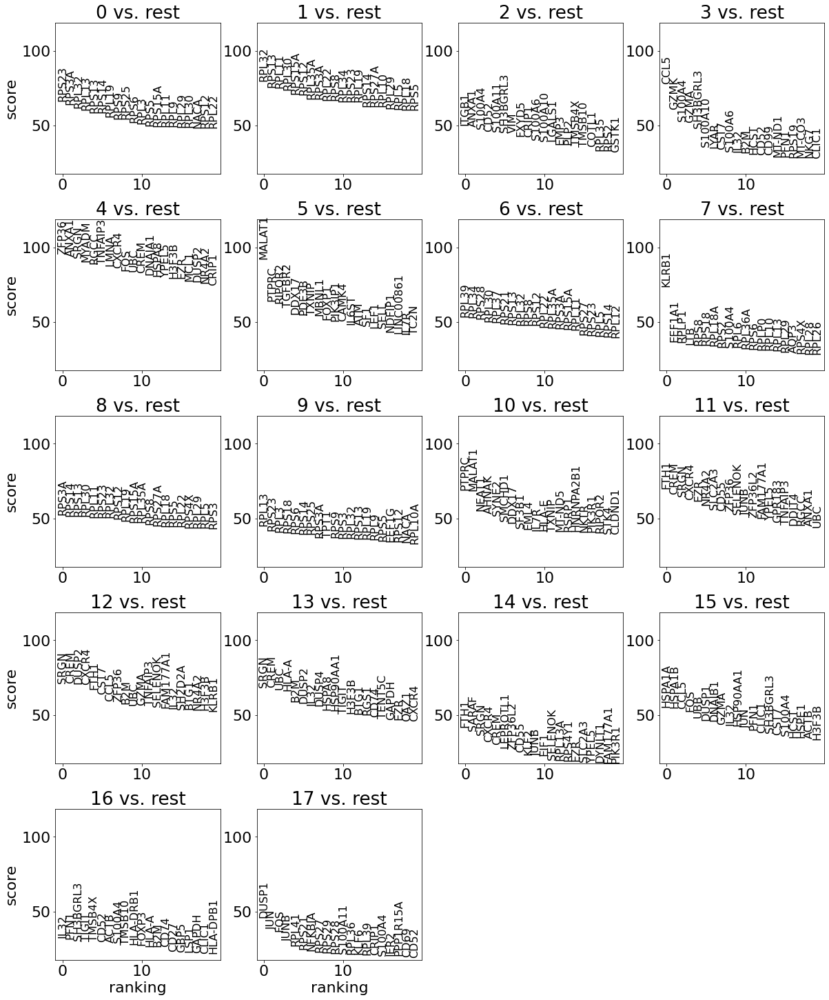

In [40]:
sc.tl.rank_genes_groups(adata_CD4, groupby='leiden_r1', key_added='rank_genes_r1', 
                        use_raw = False, method = 'wilcoxon')
rcParams['figure.figsize']=(5,5)
sc.pl.rank_genes_groups(adata_CD4, key='rank_genes_r1', fontsize=16, use_raw = False)

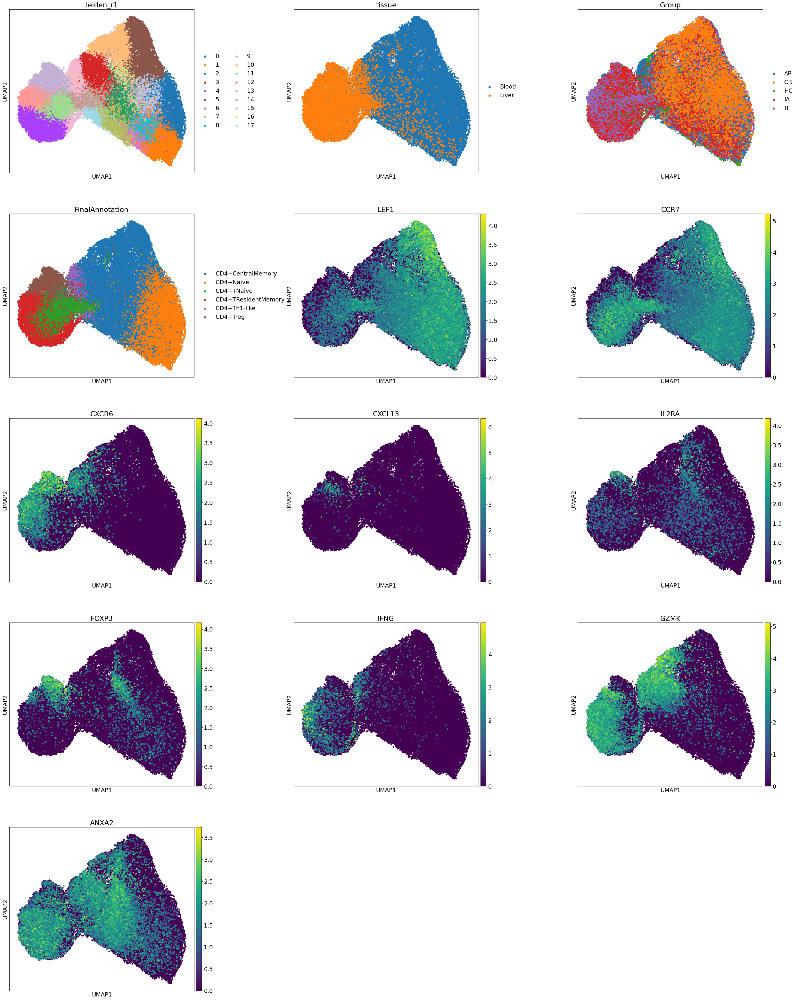

In [60]:
rcParams['figure.figsize']=(10,10)
sc.pl.umap(adata_CD4, color=['leiden_r1', 'tissue', 'Group', 'FinalAnnotation',
                                'LEF1','CCR7','CXCR6', 'CXCL13', 'IL2RA', 'FOXP3', 'IFNG', 'GZMK', 'ANXA2'],wspace = 0.4,
           s =100, ncols = 3, use_raw = False)

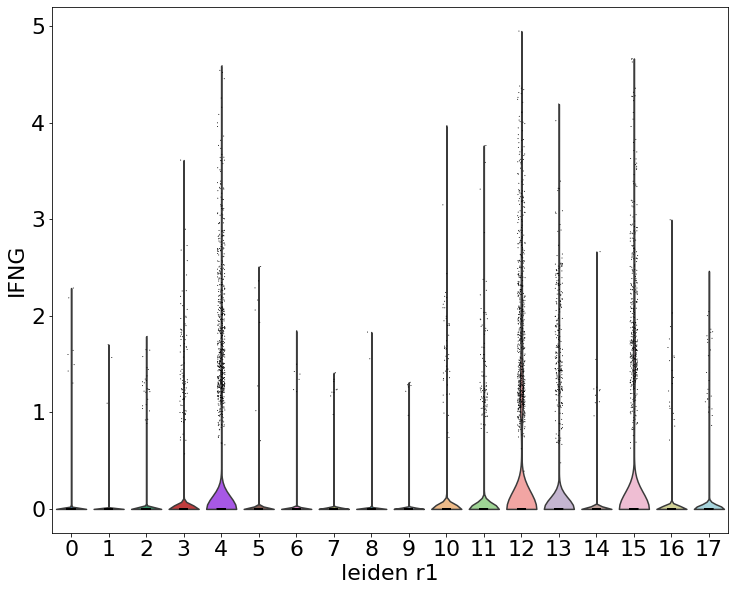

In [44]:
sc.pl.violin(adata_CD4, keys = ['IFNG'], groupby = 'leiden_r1')

In [27]:
adata_CD4.var

,gene_ids,feature_types,mt,n_cells_by_counts,mean_counts,pct_dropout_by_counts,total_counts,n_cells,highly_variable,means,dispersions,dispersions_norm
AL627309.1,ENSG00000238009,Gene Expression,False,130,0.000443,99.955716,130.0,29,False,0.000575,1.374660,-0.564794
AL627309.5,ENSG00000241860,Gene Expression,False,2109,0.007590,99.281578,2228.0,329,False,0.007062,1.507431,1.036893
AP006222.2,ENSG00000286448,Gene Expression,False,21,0.000072,99.992846,21.0,3,False,0.000050,1.076482,-1.246485
LINC01409,ENSG00000237491,Gene Expression,False,1798,0.006241,99.387519,1832.0,330,False,0.006726,1.432907,-0.164041
FAM87B,ENSG00000177757,Gene Expression,False,98,0.000337,99.966617,99.0,22,False,0.000479,1.488782,0.201394
...,...,...,...,...,...,...,...,...,...,...,...,...
AC240274.1,ENSG00000271254,Gene Expression,False,1257,0.004367,99.571808,1282.0,206,False,0.004382,1.493764,0.570641
AC004556.3,ENSG00000276345,Gene Expression,False,2699,0.009661,99.080597,2836.0,729,False,0.013486,1.263852,-2.610383
AC233755.2,ENSG00000277856,Gene Expression,False,148,0.006227,99.949584,1828.0,3,False,0.000052,1.148149,-0.945279
AC233755.1,ENSG00000275063,Gene Expression,False,290,0.089781,99.901213,26356.0,9,True,0.000233,1.845819,2.227446


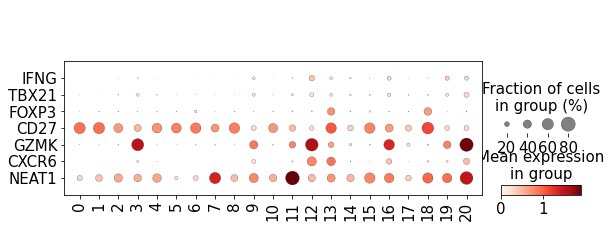

In [23]:
sc.settings.figdir = '/domino/edv/id-td-virology/Zhiyuan/public/Gut_remap/figure/T_cells/CD4/'

marker_genes = ['IFNG', 'TBX21', 'FOXP3', 'CD27', 'GZMK', 'CXCR6', 'NEAT1']

rcParams['font.size']=18
sc.pl.dotplot(adata_CD4, marker_genes, groupby='leiden_r1.5', use_raw=False, swap_axes = True)

In [46]:
#try resolution 1.5
adata_CD4.obs['leiden_r1.5'] = temp_adata.obs['res_1.5']
sc.tl.umap(adata_CD4)

/opt/conda/lib/python3.8/site-packages/scanpy/tools/_rank_genes_groups.py:394: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead.  To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'names'] = self.var_names[global_indices]
/opt/conda/lib/python3.8/site-packages/scanpy/tools/_rank_genes_groups.py:396: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead.  To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'scores'] = scores[global_indices]
/opt/conda/lib/python3.8/site-packages/scanpy/tools/_rank_genes_groups.py:399: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result 

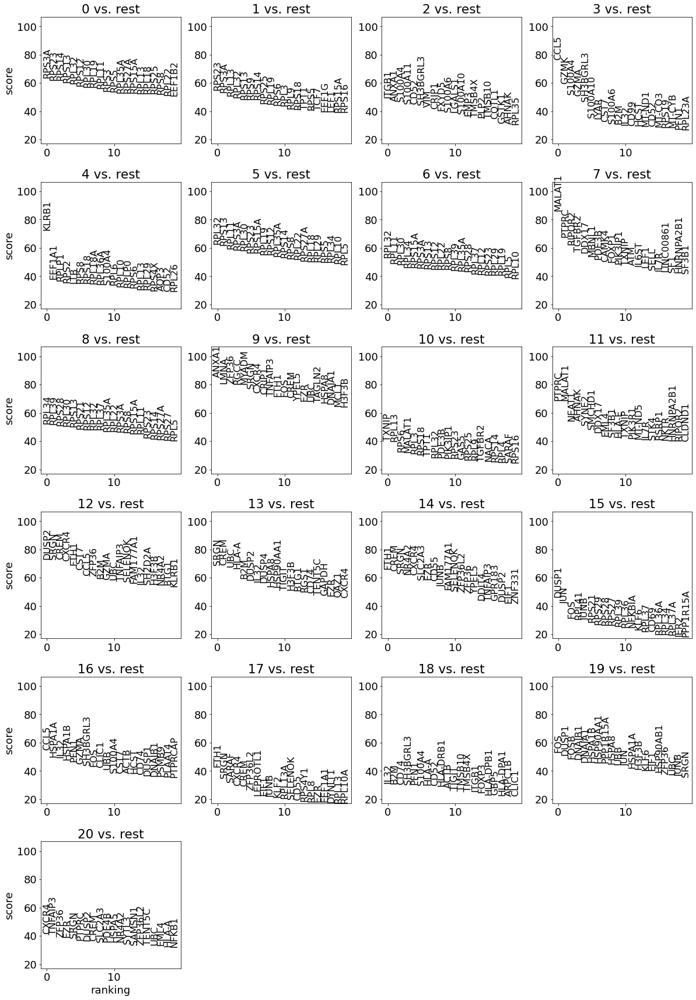

In [47]:
sc.tl.rank_genes_groups(adata_CD4, groupby='leiden_r1.5', key_added='rank_genes_r1.5', 
                        use_raw = False, method = 'wilcoxon')
rcParams['figure.figsize']=(5,5)
sc.pl.rank_genes_groups(adata_CD4, key='rank_genes_r1.5', fontsize=16, use_raw = False)

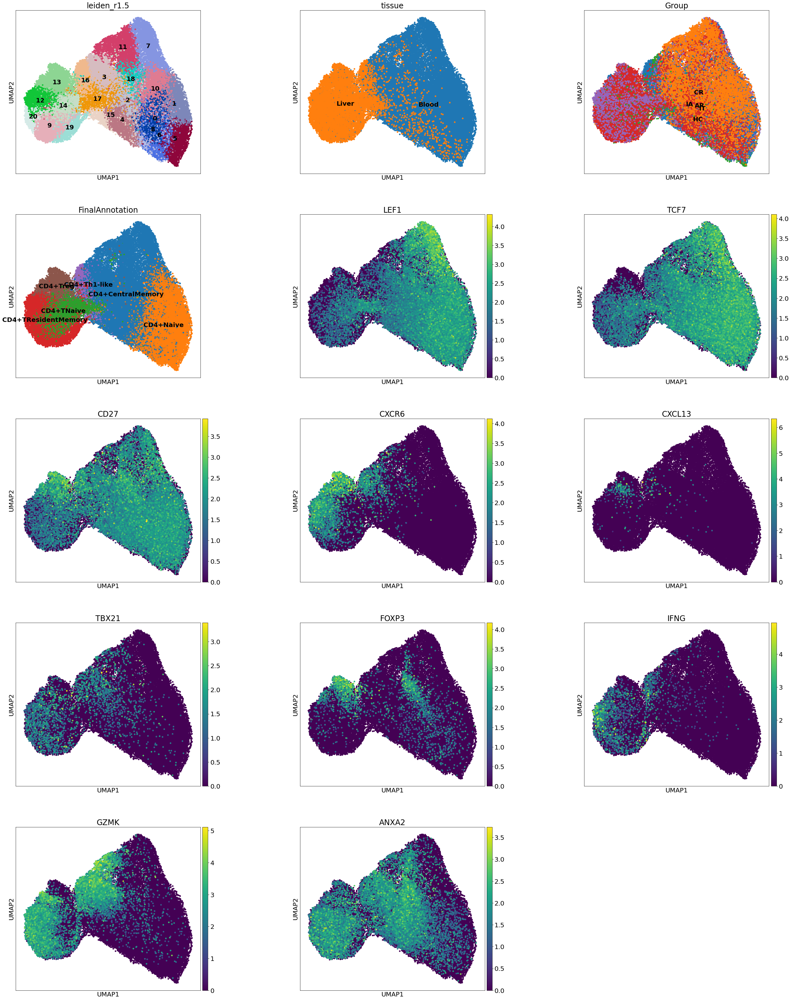

In [58]:
rcParams['figure.figsize']=(10,10)
rcParams['font.size']=20
sc.pl.umap(adata_CD4, color=['leiden_r1.5', 'tissue', 'Group', 'FinalAnnotation',
                                'LEF1','TCF7','CD27','CXCR6', 'CXCL13', 'TBX21', 'FOXP3', 'IFNG', 'GZMK', 'ANXA2'],wspace = 0.4,
           s =100, ncols = 3, use_raw = False, legend_loc = 'on data')

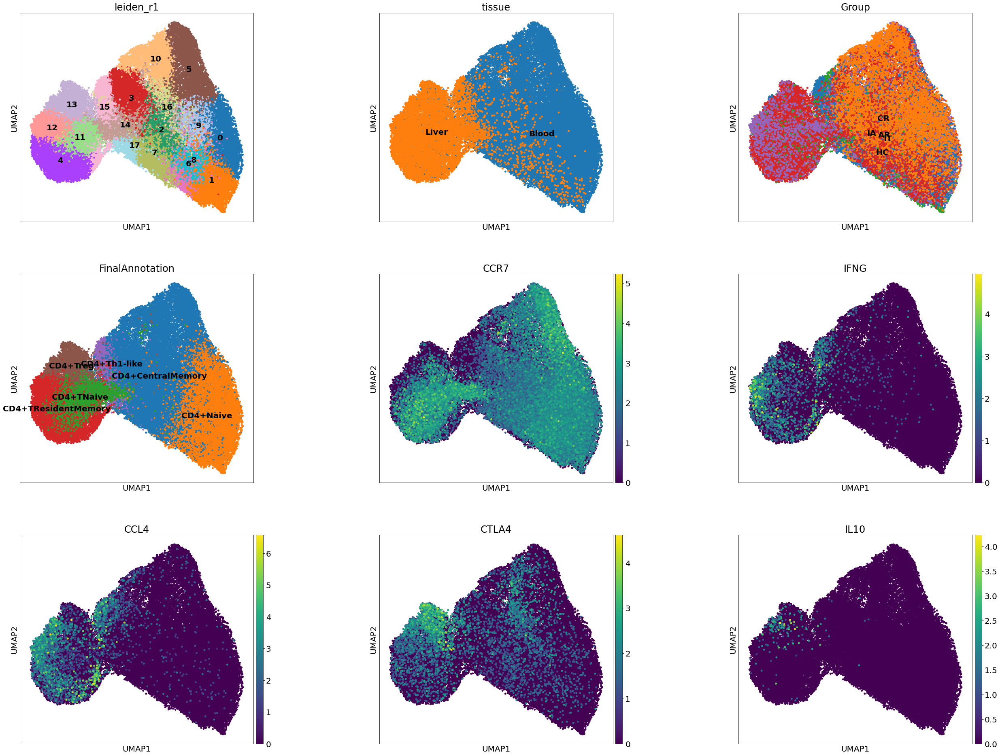

In [67]:
rcParams['figure.figsize']=(10,10)
rcParams['font.size']=20
sc.pl.umap(adata_CD4, color=['leiden_r1', 'tissue', 'Group', 'FinalAnnotation', 'CCR7', 'IFNG', 'CCL4', 'CTLA4', 'IL10'],wspace = 0.4,
           s =100, ncols = 3, use_raw = False, legend_loc = 'on data')

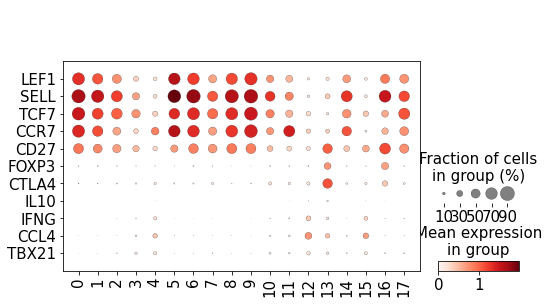

In [13]:
sc.settings.figdir = '/domino/edv/id-td-virology/Zhiyuan/public/Gut_remap/figure/T_cells/CD4/'


marker_genes = ['LEF1', 'SELL', 'TCF7','CCR7', 
                'CD27', 
                'FOXP3', 'CTLA4', 'IL10',
                'IFNG', 'CCL4', 'TBX21'
               ]

rcParams['font.size']=18
sc.pl.dotplot(adata_CD4, marker_genes, groupby='leiden_r1', use_raw=False, swap_axes = True)

In [22]:
adata_CD4.obs.subtype.unique()

['CD4+ intermediate', 'CD4+ Th1_like', 'CD4+ Treg CTLA4++', 'CD4+ Treg SELL++', 'CD4+ Naive/cm']
Categories (5, object): ['CD4+ Naive/cm', 'CD4+ intermediate', 'CD4+ Treg SELL++', 'CD4+ Treg CTLA4++', 'CD4+ Th1_like']

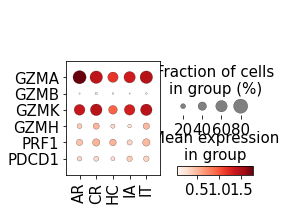

In [29]:
sc.settings.figdir = '/domino/edv/id-td-virology/Zhiyuan/public/Gut_remap/figure/T_cells/CD4/'
temp = adata_CD4[adata_CD4.obs.subtype == 'CD4+ Th1_like']

marker_genes = ['GZMA', 'GZMB', 'GZMK', 'GZMH','PRF1', 'PDCD1'
               ]

rcParams['font.size']=18
sc.pl.dotplot(temp, marker_genes, groupby='Group', use_raw=False, swap_axes = True)

In [94]:
adata_CD4.obs.drop(columns='subtype', inplace = True)

In [97]:
adata_CD4.obs['subtype'] = adata_CD4.obs['leiden_r1'].cat.add_categories(['CD4+ Naive/cm',
                                                                          'CD4+ intermediate',
                                                                         'CD4+ Treg SELL++',
                                                                         'CD4+ Treg CTLA4++',
                                                                         'CD4+ Th1_like'
                                                                         ])

adata_CD4.obs['subtype'][np.in1d(adata_CD4.obs['leiden_r1'], ['0','1','5','6','8','9'])] = 'CD4+ Naive/cm'
adata_CD4.obs['subtype'][np.in1d(adata_CD4.obs['leiden_r1'], ['4', '12', '15'])] = 'CD4+ Th1_like'
adata_CD4.obs['subtype'][np.in1d(adata_CD4.obs['leiden_r1'], ['13'])] = 'CD4+ Treg CTLA4++'
adata_CD4.obs['subtype'][np.in1d(adata_CD4.obs['leiden_r1'], ['16'])] = 'CD4+ Treg SELL++'
adata_CD4.obs['subtype'][np.in1d(adata_CD4.obs['leiden_r1'], ['2', '3', '7', '10', '11', '14', '17'])] = 'CD4+ intermediate'



adata_CD4.obs['subtype'] = adata_CD4.obs['subtype'].cat.remove_unused_categories()


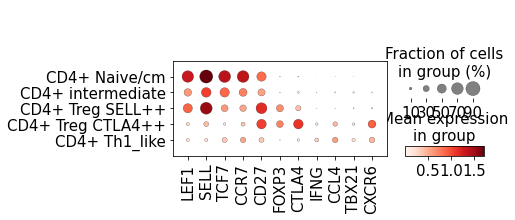

In [110]:
sc.settings.figdir = '/domino/edv/id-td-virology/Zhiyuan/public/Gut_remap/figure/T_cells/CD4/'

rcParams['figure.figsize']=(5,15)
rcParams['font.size']=18

marker_genes = ['LEF1', 'SELL', 'TCF7','CCR7', 
                'CD27', 
                'FOXP3', 'CTLA4',
                'IFNG', 'CCL4', 'TBX21',
                'CXCR6']


sc.pl.dotplot(adata_CD4, marker_genes, groupby='subtype', use_raw=False, 
              swap_axes = False, save = '_final_dotplot.png')




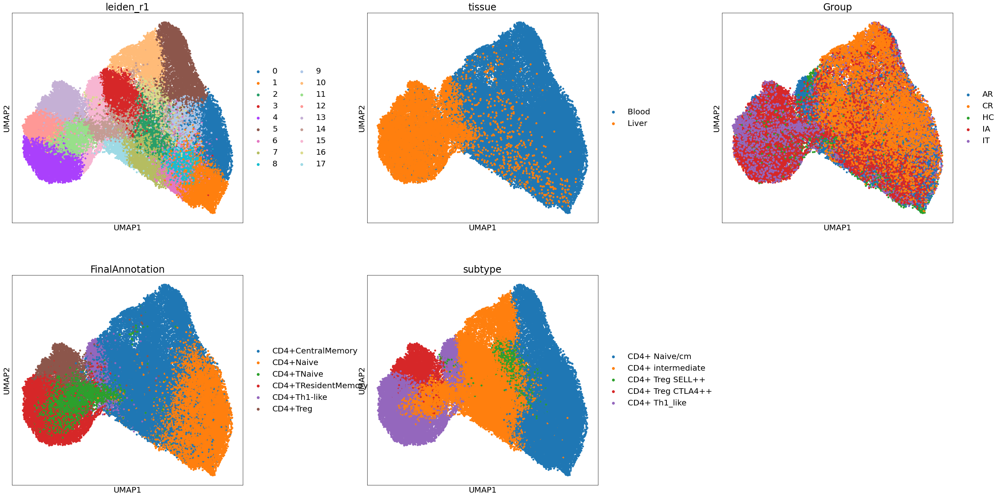

In [99]:
rcParams['figure.figsize']=(10,10)
rcParams['font.size']=20
sc.pl.umap(adata_CD4, color=['leiden_r1', 'tissue', 'Group', 'FinalAnnotation', 'subtype'],wspace = 0.4,
           s =100, ncols = 3, use_raw = False)

In [124]:
savepath = '/domino/edv/id-td-virology/Zhiyuan/public/Gut_remap/processed_data/CD4.h5ad'
adata_CD4.write(savepath)

In [2]:
savepath = '/domino/edv/id-td-virology/Zhiyuan/public/Gut_remap/processed_data/CD4.h5ad'
adata_CD4 = sc.read_h5ad(savepath)

In [4]:
#load source metadata
#load metadata from the authors from the gut paper
src_data_path = '/domino/edv/id-td-virology/Zhiyuan/public/Gut/processed_data/Gut2022_ttlsc_annotations.csv'
src_meta = pd.read_csv(src_data_path,index_col = 0)

In [43]:
a = src_meta.loc[src_meta.majorCluster == 'CD4_T']

In [44]:
a

,batch,patientID,tissue,stage,majorCluster,subCluster,clonal_TCR,clone.seq_TCR,clonal_BCR,clone.seq_BCR
index,,,,,,,,,,
AAACCTGAGACTACAA-1-P190808_Blood_2,P190808_Blood_2,P190808,Blood,IT,CD4_T,CD4T_c01-LEF1,False,P190808_TRAV8-4_TGTGCTGTGGGGGATACTGGAGGCTTCAAA...,NaN,NaN
AAACGGGAGACAAGCC-1-P190808_Blood_2,P190808_Blood_2,P190808,Blood,IT,CD4_T,CD4T_c01-LEF1,NaN,NaN,NaN,NaN
AAACGGGAGCTGCAAG-1-P190808_Blood_2,P190808_Blood_2,P190808,Blood,IT,CD4_T,CD4T_c01-LEF1,False,P190808_TRAV27_TGTACAACTGGGGCAAACAACCTCTTCTTT_...,NaN,NaN
AAACGGGAGTCCGTAT-1-P190808_Blood_2,P190808_Blood_2,P190808,Blood,IT,CD4_T,CD4T_c02-ANXA2,False,P190808_TRAV23/DV6_TGTGCAGCAAGCCCCATTCTCTACAAG...,NaN,NaN
AAACGGGCACATGTGT-1-P190808_Blood_2,P190808_Blood_2,P190808,Blood,IT,CD4_T,CD4T_c01-LEF1,False,P190808_TRAV20_TGTGCTGCAGCCGACAGCTGGGGGAAATTCC...,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...
TTTGTCAGTCCTCCAT-1-P191112_Blood_1,P191112_Blood_1,P191112,Blood,IA,CD4_T,CD4T_c02-ANXA2,False,P191112_TRAV9-2_TGTGCTCTGAGGGTAGGGAACACCGGTAAC...,NaN,NaN
TTTGTCAGTTCCGTCT-1-P191112_Blood_1,P191112_Blood_1,P191112,Blood,IA,CD4_T,CD4T_c01-LEF1,False,P191112_TRAV12-2_TGTGCCTTAGGGCTCACCTTT_TRAJ11:...,NaN,NaN
TTTGTCATCAACGAAA-1-P191112_Blood_1,P191112_Blood_1,P191112,Blood,IA,CD4_T,CD4T_c04-FOXP3,NaN,NaN,NaN,NaN


In [7]:
len(adata_CD4.obs.index)

64518

In [45]:
ol = [x for x in adata_CD4.obs.index if x in a.index]

In [46]:
len(ol)

50890

In [111]:
test = adata_CD4[ol]
src_meta_2 = src_meta.loc[ol]
df = src_meta_2[['batch', 'patientID', 'tissue', 'stage', 'majorCluster','subCluster']].copy()
df.loc[ol,'GeneralAnnotation'] = adata_CD4.obs.loc[ol, 'GeneralAnnotation']
df.loc[ol,'FinalAnnotation'] = adata_CD4.obs.loc[ol, 'FinalAnnotation']
df.loc[ol,'subtype'] = adata_CD4.obs.loc[ol, 'subtype']
df.loc[ol,'SecondAnnotation'] = adata_CD4.obs.loc[ol, 'SecondAnnotation']

In [112]:
df_2 = df.groupby(['subCluster', 'subtype'], observed = True).size().unstack()

In [113]:
ind = [x for x in df_2.index if x.startswith('CD4')]
df_3 = df_2.loc[ind].copy().fillna(0)

In [114]:
df_3

subtype,CD4+ intermediate,CD4+ Th1_like,CD4+ Treg CTLA4++,CD4+ Treg SELL++,CD4+ Naive/cm
subCluster,,,,,
CD4T_c01-LEF1,3003.0,18.0,6.0,68.0,19329.0
CD4T_c02-ANXA2,12067.0,480.0,0.0,401.0,1772.0
CD4T_c03-GNLY,181.0,58.0,1.0,2.0,0.0
CD4T_c04-FOXP3,641.0,6.0,14.0,1463.0,919.0
CD4T_c05-CCR7,1645.0,188.0,108.0,3.0,5.0
CD4T_c06-IFI44L,152.0,2.0,1.0,20.0,249.0
CD4T_c07-TIMP1,1357.0,1798.0,12.0,0.0,0.0
CD4T_c08-GZMK,166.0,1932.0,56.0,0.0,0.0
CD4T_c09-CTLA4,41.0,62.0,1033.0,40.0,0.0


In [115]:
ind_test = src_meta_2.loc[src_meta_2.subCluster == 'CD4T_c10-CXCL13'].index

In [119]:
adata_CD4.obs['ori_CXCL13'] = 'no'
adata_CD4.obs.loc[ind_test, 'ori_CXCL13'] = 'yes'

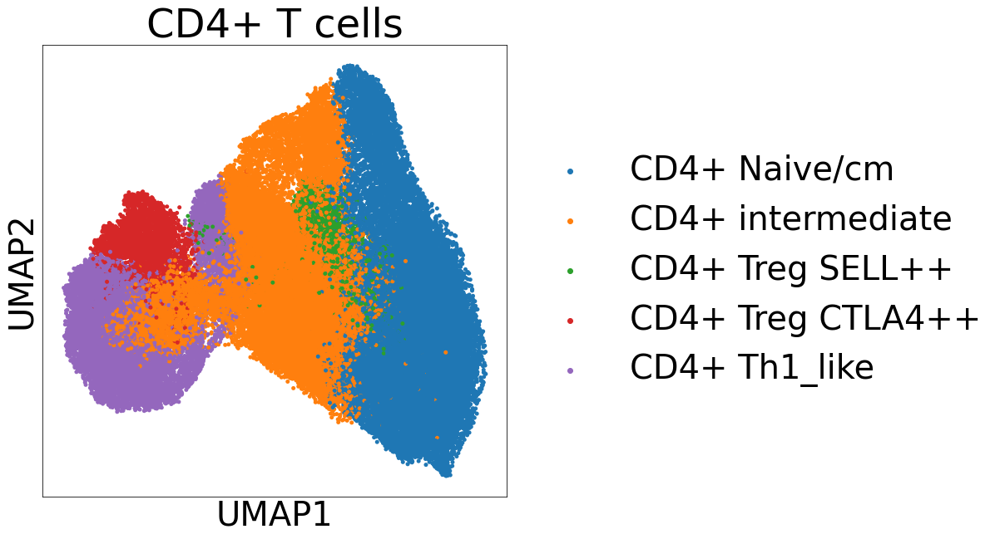

In [4]:
sc.settings.figdir = '/domino/edv/id-td-virology/Zhiyuan/public/Gut_remap/figure/T_cells/CD4/'
rcParams['figure.figsize']=(10,10)
rcParams['font.size']=40
sc.pl.umap(adata_CD4, color=['subtype'],wspace = 0.4, title = 'CD4+ T cells',
           s =100, ncols = 2, use_raw = False, save = 'for_pre.png')

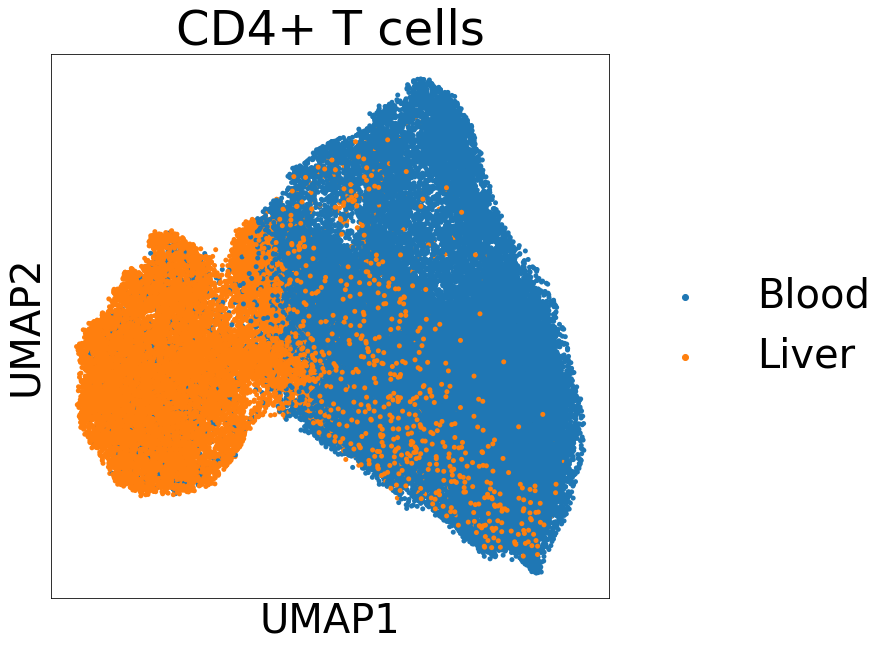

In [7]:
sc.settings.figdir = '/domino/edv/id-td-virology/Zhiyuan/public/Gut_remap/figure/T_cells/CD4/'
rcParams['figure.figsize']=(10,10)
rcParams['font.size']=40
sc.pl.umap(adata_CD4, color=['tissue'],wspace = 0.4, title = 'CD4+ T cells',
           s =100, ncols = 2, use_raw = False, save = 'for_pre_3.png')

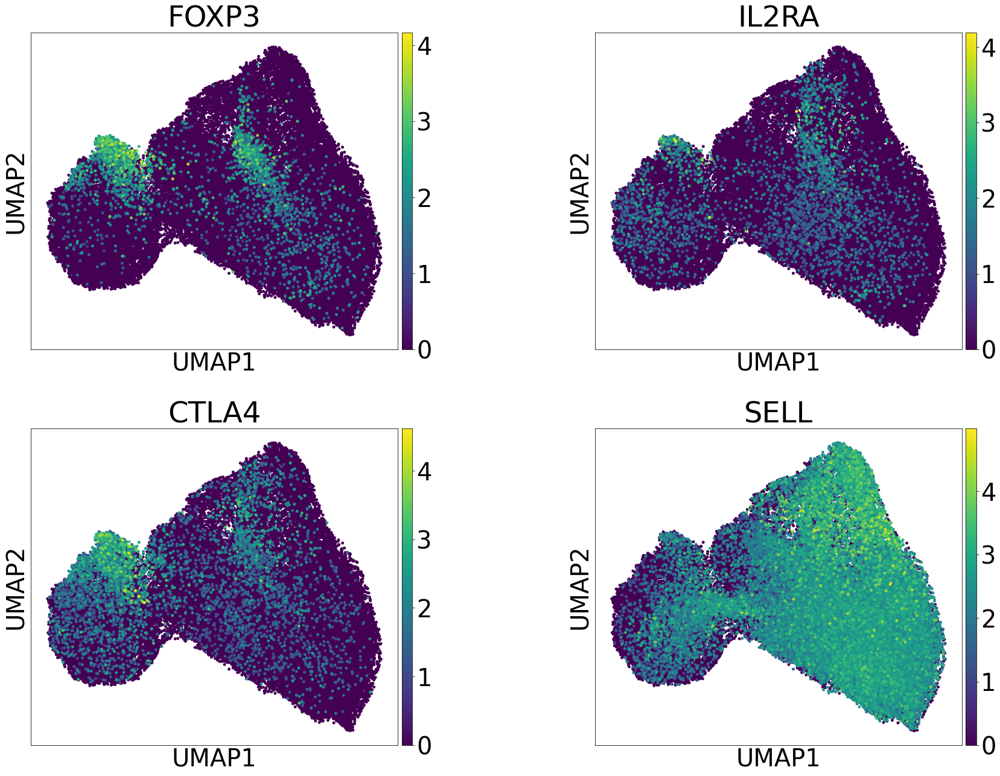

In [9]:
sc.settings.figdir = '/domino/edv/id-td-virology/Zhiyuan/public/Gut_remap/figure/T_cells/CD4/'
rcParams['figure.figsize']=(10,10)
rcParams['font.size']=40
sc.pl.umap(adata_CD4, color=['FOXP3', 'IL2RA', 'CTLA4', 'SELL'],wspace = 0.4, 
           s =100, ncols = 2, use_raw = False, save = 'for_pre_2.png')

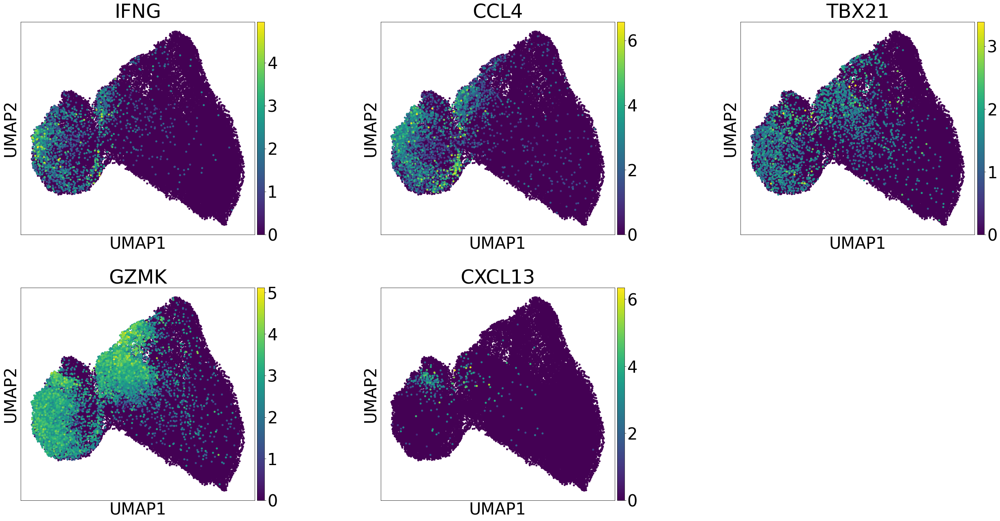

In [3]:
sc.settings.figdir = '/domino/edv/id-td-virology/Zhiyuan/public/Gut_remap/figure/T_cells/CD4/'
rcParams['figure.figsize']=(10,10)
rcParams['font.size']=40
sc.pl.umap(adata_CD4, color=['IFNG', 'CCL4', 'TBX21', 'GZMK', 'CXCL13'],wspace = 0.4, 
           s =100, ncols = 3, use_raw = False, save = 'Th1.png')

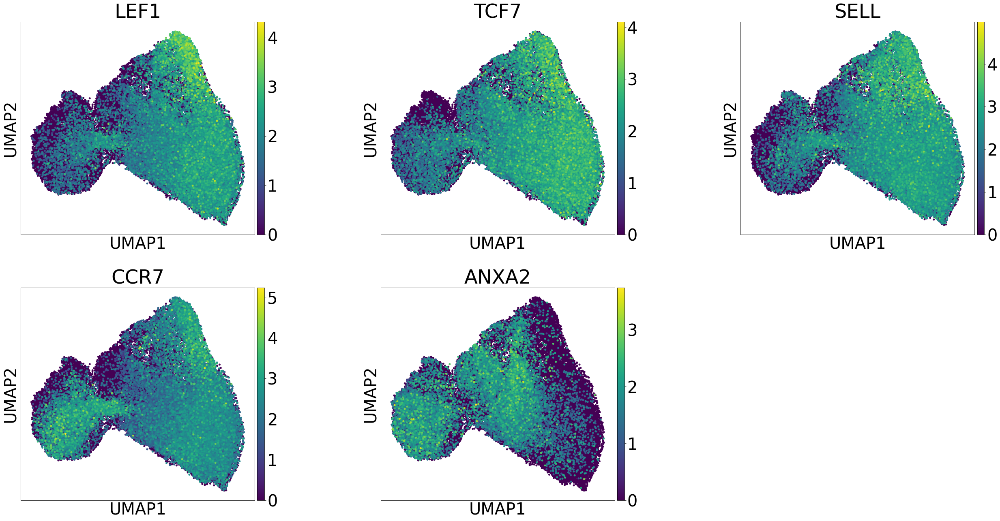

In [5]:
sc.settings.figdir = '/domino/edv/id-td-virology/Zhiyuan/public/Gut_remap/figure/T_cells/CD4/'
rcParams['figure.figsize']=(10,10)
rcParams['font.size']=40
sc.pl.umap(adata_CD4, color=['LEF1', 'TCF7', 'SELL','CCR7', 'ANXA2'],wspace = 0.4, 
           s =100, ncols = 3, use_raw = False, save = 'naive.png')

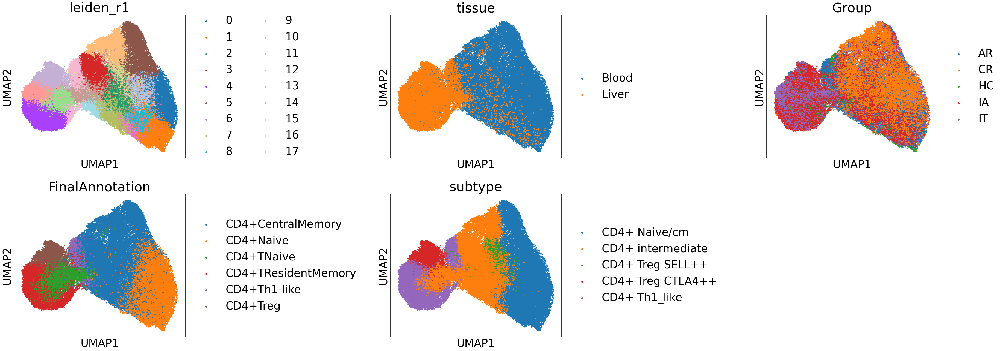

In [8]:
sc.settings.figdir = '/domino/edv/id-td-virology/Zhiyuan/public/Gut_remap/figure/T_cells/CD4/'
rcParams['figure.figsize']=(10,10)
rcParams['font.size']=40
sc.pl.umap(adata_CD4, color=['leiden_r1', 'tissue', 'Group', 'FinalAnnotation', 'subtype'],wspace = 1, 
           s =100, ncols = 3, use_raw = False, save = 'for_pre_4.png')

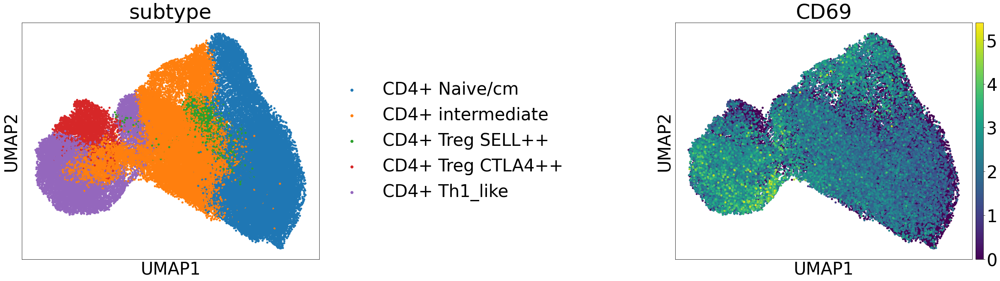

In [9]:
sc.settings.figdir = '/domino/edv/id-td-virology/Zhiyuan/public/Gut_remap/figure/T_cells/CD4/'
rcParams['figure.figsize']=(10,10)
rcParams['font.size']=40
sc.pl.umap(adata_CD4, color=['subtype', 'CD69'],wspace = 1, 
           s =100, ncols = 3, use_raw = False)